### Importy bibliotek


In [546]:
import os
import json

import string

import morfeusz2
import pandas as pd
import numpy as np
import itertools as it

import operator as op
import matplotlib.pyplot as plt

from wordcloud import WordCloud

from nltk.util import ngrams
from nltk.tokenize import word_tokenize
from nltk.corpus import PlaintextCorpusReader
from scipy.cluster.hierarchy import dendrogram
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics.pairwise import cosine_similarity, euclidean_distances
from sklearn.decomposition import LatentDirichletAllocation, NMF
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

1. Utworzenie korpusu dokumentów


In [547]:
corpus_dir = "./nowa_literatura"
corpus = PlaintextCorpusReader(corpus_dir, ".*\.txt")
files = corpus.fileids()
files

['1984.txt',
 'Antygona.txt',
 'Balladyna.txt',
 'Dziady czesc III.txt',
 'Hamlet.txt',
 'Hrabia Monte Christo.txt',
 'Iliada.txt',
 'Krol Edyp.txt',
 'Opowiesc wigilijna.txt',
 'Pan Tadeusz.txt',
 'Pan Wołodyjowski.txt',
 'Przedwiosnie.txt',
 'Quo vadis.txt',
 'Romeo i Julia.txt',
 'Skapiec.txt',
 'Tako rzecze Zaratustra.txt',
 'W pustyni i w puszczy.txt',
 'Wesele.txt',
 'Wspomnienia z martwego domu.txt',
 'Zemsta.txt']

2. Wstępne przygotowanie dokumentów


In [548]:
documents = {}

for f in files:
    documents[f] = corpus.raw(f)
print(json.dumps(documents, indent=4, ensure_ascii=False))

{
    "1984.txt": "George Orwell\r\n\r\nRok 1984\r\ntłum. Julia Fiedorczuk\r\n\r\nISBN 978-83-288-7049-9\r\n\r\n\r\n\r\n\r\nOd tłumaczki\r\n\r\nRóżne bywają powody, dla których dokonuje się ponownego przekładu dzieła literackiego już obecnego w danym języku. Najczęściej tłumacz lub tłumaczka czują, iż istniejący przekład jest niedobry albo przestarzały i jako taki wymaga korekty. Czasem jednak chodzi o pokusę samodzielnego zmierzenia się z jakimś ważnym tekstem i przedstawienia własnej — niekoniecznie doskonalszej — interpretacji. Podjęłam się tłumaczenia Roku 1984 z tego drugiego powodu, znajdując dodatkową motywację w fakcie, iż wykonuję tę pracę dla „Wolnych Lektur”, których działania na rzecz popularyzacji i zwiększania dostępności literatury są mi bardzo bliskie. Moje punkty odniesienia to dwa klasyczne spolszczenia powieści Orwella: wersja Juliusza Mieroszewskiego z 1979 roku i o blisko dekadę późniejszy przekład Tomasza Mirkowicza, którym zaczytywałam się jako licealistka. Nie b

In [549]:
stoplist_file = open("./stopwords_pl.txt", "r", encoding="UTF-8")
stoplist = stoplist_file.read().splitlines()
stoplist_file.close()
stoplist = stoplist[4:]
stoplist

['vol',
 'o.o.',
 'mgr',
 'godz',
 'zł',
 'www',
 'pl',
 'ul',
 'tel',
 'hab',
 'prof',
 'inż',
 'dr',
 'i',
 'u',
 'aby',
 'albo',
 'ale',
 'ani',
 'aż',
 'bardzo',
 'bez',
 'bo',
 'bowiem',
 'by',
 'byli',
 'bym',
 'był',
 'była',
 'było',
 'były',
 'być',
 'będzie',
 'będą',
 'chce',
 'choć',
 'co',
 'coraz',
 'coś',
 'czy',
 'czyli',
 'często',
 'dla',
 'do',
 'gdy',
 'gdyby',
 'gdyż',
 'gdzie',
 'go',
 'ich',
 'im',
 'inne',
 'iż',
 'ja',
 'jak',
 'jakie',
 'jako',
 'je',
 'jednak',
 'jednym',
 'jedynie',
 'jego',
 'jej',
 'jest',
 'jeszcze',
 'jeśli',
 'jeżeli',
 'już',
 'ją',
 'kiedy',
 'kilku',
 'kto',
 'która',
 'które',
 'którego',
 'której',
 'który',
 'których',
 'którym',
 'którzy',
 'lat',
 'lecz',
 'lub',
 'ma',
 'mają',
 'mamy',
 'mi',
 'miał',
 'mimo',
 'mnie',
 'mogą',
 'może',
 'można',
 'mu',
 'musi',
 'na',
 'nad',
 'nam',
 'nas',
 'nawet',
 'nic',
 'nich',
 'nie',
 'niej',
 'nim',
 'niż',
 'no',
 'nowe',
 'np',
 'nr',
 'o',
 'od',
 'ok',
 'on',
 'one',
 'oraz',
 '

In [550]:
# lematyzacja - sprowadzenie do formy podstawowej
def lemmatize(text):
    morf = morfeusz2.Morfeusz()
    segments = it.groupby(morf.analyse(text), op.itemgetter(0, 1))

    def disambiguate(group):
        pairs = (
            (len(descr), lemma)
            for _, _, (
                _,
                lemma,
                descr,
                _,
                _,
            ) in group
        )
        perpl, lemma = min(pairs)
        return lemma.split(":")[0]

    lemmas = (disambiguate(group) for key, group in segments)
    return " ".join(filter(str.isalpha, lemmas))

In [551]:
morf = morfeusz2.Morfeusz()
morf.analyse("Ala ma kota, a kot ma Ale. Ala go kocha, a on ją wcale")

[(0, 1, ('Ala', 'Ala', 'subst:sg:nom:f', ['imię'], [])),
 (0, 1, ('Ala', 'Al', 'subst:sg:gen.acc:m1', ['imię'], [])),
 (0, 1, ('Ala', 'Alo', 'subst:sg:gen.acc:m1', ['imię'], [])),
 (1, 2, ('ma', 'mieć', 'fin:sg:ter:imperf', [], [])),
 (1, 2, ('ma', 'mój:A', 'adj:sg:nom.voc:f:pos', [], [])),
 (2, 3, ('kota', 'kota', 'subst:sg:nom:f', ['nazwa_pospolita'], [])),
 (2,
  3,
  ('kota',
   'kot:Sm1',
   'subst:sg:gen.acc:m1',
   ['nazwa_pospolita'],
   ['pot.,środ.'])),
 (2, 3, ('kota', 'kot:Sm2', 'subst:sg:gen.acc:m2', ['nazwa_pospolita'], [])),
 (3, 4, (',', ',', 'interp', [], [])),
 (4, 5, ('a', 'a:C', 'conj', [], [])),
 (4, 5, ('a', 'a:I', 'interj', [], [])),
 (4, 5, ('a', 'a:P', 'prep:nom', [], [])),
 (4, 5, ('a', 'a:T', 'part', [], [])),
 (5,
  6,
  ('kot', 'kot:Sm1', 'subst:sg:nom:m1', ['nazwa_pospolita'], ['pot.,środ.'])),
 (5, 6, ('kot', 'kot:Sm2', 'subst:sg:nom:m2', ['nazwa_pospolita'], [])),
 (5, 6, ('kot', 'kota', 'subst:pl:gen:f', ['nazwa_pospolita'], [])),
 (6, 7, ('ma', 'mieć',

In [552]:
for key in documents:
    documents[key] = documents[key].lower()
    documents[key] = "".join(
        [char for char in documents[key] if char not in string.punctuation]
    )
    documents[key] = lemmatize(documents[key])
    documents[key] = " ".join(
        [
            word
            for word in word_tokenize(documents[key], language="polish")
            if word not in stoplist
        ]
    )

3. Utowrzenie macierzy częstości


In [553]:
docs = pd.DataFrame.from_dict(documents, orient="index")
docs.columns = ["content"]
docs

,content
1984.txt,George Orwell rok tłumić Julia Fiedorczuk ISBN...
Antygona.txt,Sofokles Antygona tłumić Kazimierza morawski I...
Balladyna.txt,Juliusz słowacki Balladyna tragedia pięć akt I...
Dziady czesc III.txt,Adam Mickiewicz dziad poema dziad część ISBN ś...
Hamlet.txt,William Shakespeare hamlet królewicz duński tł...
Hrabia Monte Christo.txt,Aleksandra Dumas ojciec hrabia Monte Christo t...
Iliada.txt,Homer Iliada tłumić Franciszka Ksawera Dmochow...
Krol Edyp.txt,Sofokles król Edyp tłumić Kazimierza morawski ...
Opowiesc wigilijna.txt,Charles Dickens opowieść wigilijny tłumić niez...
Pan Tadeusz.txt,Adam Mickiewicz Tadeusz ostatni zajazd litwa I...


In [554]:
count_vectorizer = CountVectorizer()
counts_tf = count_vectorizer.fit_transform(docs["content"])
counts_tf = counts_tf.toarray()
counts_tf

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 1, 0],
       [0, 0, 0, ..., 0, 0, 3],
       ...,
       [1, 0, 0, ..., 1, 1, 0],
       [1, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], shape=(20, 40652))

In [555]:
tfidf_vectorizer = TfidfVectorizer()
counts_tfidf = tfidf_vectorizer.fit_transform(docs["content"])
counts_tfidf = counts_tfidf.toarray()
counts_tfidf

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.00621796,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.00438875],
       ...,
       [0.00227052, 0.        , 0.        , ..., 0.00286258, 0.00227052,
        0.        ],
       [0.00127044, 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]], shape=(20, 40652))

4. Chmury tagów


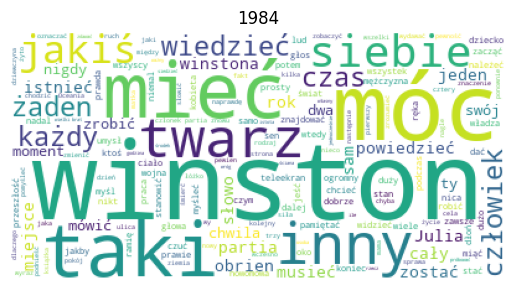

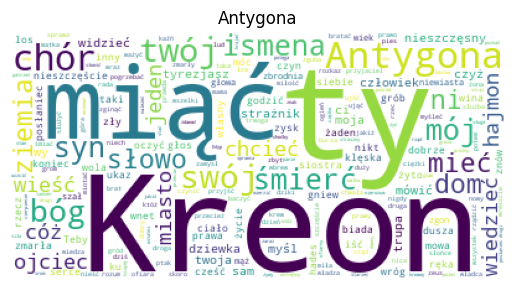

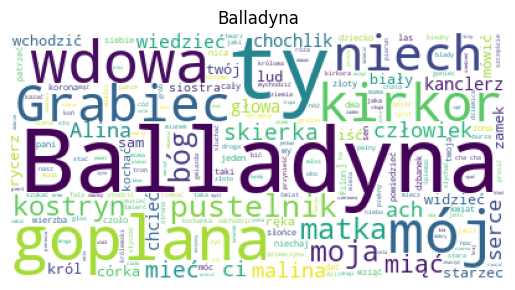

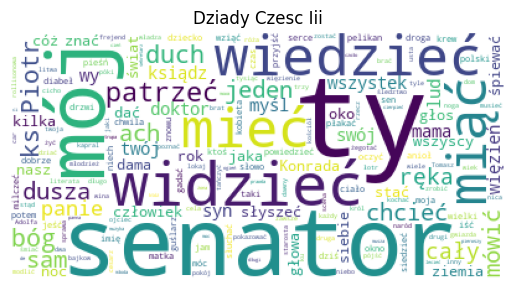

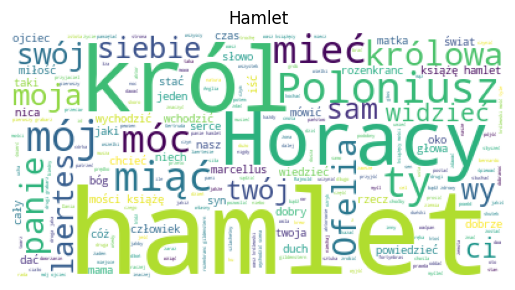

...

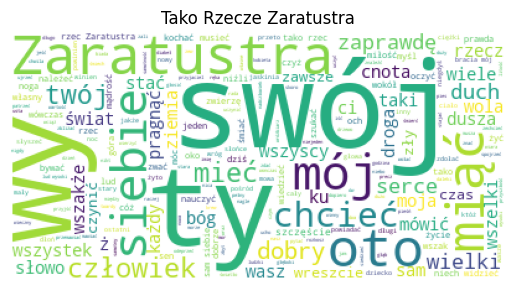

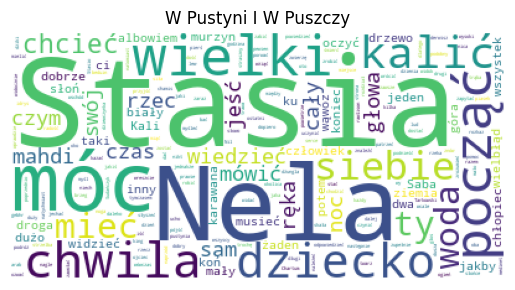

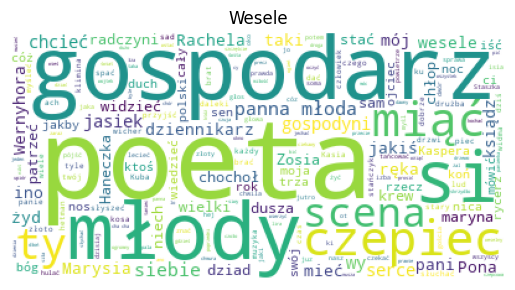

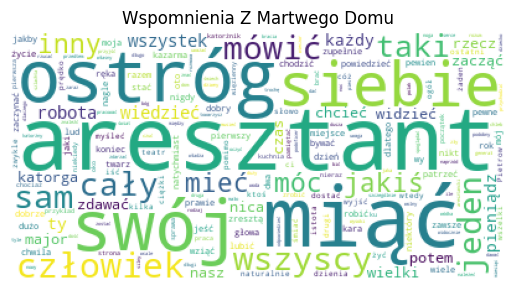

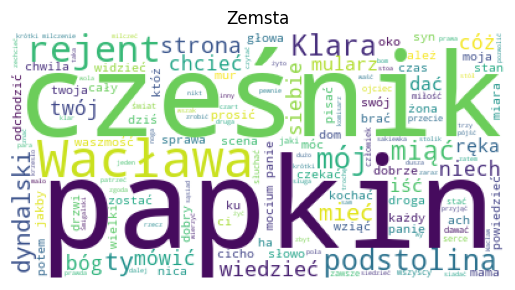

In [556]:
wordcloud = WordCloud(
    background_color="white", max_words=5000, contour_width=3, contour_color="steelblue"
)
if not os.path.exists("./chmury"):
    os.mkdir("./chmury")
for index, row in docs.iterrows():
    wordcloud.generate(row["content"])
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.title(index.replace(".txt", "").replace("_", " ").title())
    plt.savefig(f"./chmury/{index}.png", format="png", dpi=300)
    plt.show()

# Analiza rozpoznawalności źródeł na podstawie chmur słów

### 🟢 BARDZO ŁATWE DO ROZPOZNANIA 

| Utwór | Słowa kluczowe | Dlaczego łatwe |
|-------|----------------|----------------|
| **Wesele** | gospodarz, poeta, młody, żep, scena | Wyraźne nawiązania do weselnej uroczystości |
| **Zemsta** | Cześnik, papkin, Wacława | Unikalne imiona postaci z komedii |
| **1984** | Winston, mieć, tak, czuć | Charakterystyczna leksyka orwellowska |
| **Antygona** | Antygona, Kreon, Ismena, ty | Imiona głównych bohaterów tragedii |
| **Hamlet** | Hamlet, Horatio, król, Poloniusz | Shakespearowskie imiona postaci |
| **Iliada** | Hektor, Trojan, bog, rycerz | Mitologia grecka i elementy epiki |
| **Pan Tadeusz** | Tadeusz, sędzia, Wojski, Soplicowo | Charakterystyczne imiona i toponimy |
| **Pan Wołodyjowski** | Basia, Zagłoba, Wołodyjowski | Unikalne imiona z Trylogii Sienkiewicza |
| **Romeo i Julia** | Romeo, Julia, Marta | Klasyczne imiona głównych bohaterów |
| **W Pustyni i w Puszczy** | Staś, Kali, Nel, Mogdad | Charakterystyczne imiona przygodowe |


### 🟡 ŚREDNIO ROZPOZNAWALNE 

| Utwór | Słowa kluczowe | Problemy z rozpoznaniem |
|-------|----------------|-------------------------|
| **Balladyna** | Balladyna, Grabiec, Kirkor, wdowa | Słowa charakterystyczne, ale mogą mylić z innymi dramatami |
| **Dziady cz. III** | senator, Piotr, widzieć, ty | Leksyka patriotyczna, ale nie unikalna |
| **Hrabia Monte Christo** | hrabia, Monte Christo, mieć | Tytuł w tekście, ale ogólne słownictwo |
| **Król Edyp** | Edyp, Jokasta, Kreon, człowiek | Mitologia grecka, ale podobna do Antygony |
| **Quo Vadis** | Winius, Petroniusz, rzecz, móc | Starożytny Rzym, ale słownictwo ogólne |
| **Skąpiec** | Harpagon, Eliza, Walery, Marianna | Imiona postaci, ale nie bardzo charakterystyczne |


### 🔴 TRUDNE DO ROZPOZNANIA 

| Utwór | Słowa kluczowe | Dlaczego trudne |
|-------|----------------|-----------------|
| **Wspomnienia z Martwego Domu** | osadzać, aresztant, katorga, siebie | Kontekst więzienny, ale słownictwo ogólne |
| **Opowieść Wigilijna** | Scrooge, duch, siebie, człowiek | "Scrooge" charakterystyczny, ale reszta ogólna |
| **Przedwiośnie** | Cezary, siebie, sam, móc | Imię głównego bohatera, ale słownictwo neutralne |
| **Tako Rzecze Zaratustra** | Zaratustra, swoją, człowiek, móc | Filozoficzne, ale słownictwo abstrakcyjne |


### **DRAMATY I KOMEDIE**
- **Najłatwiejsze**: Wesele, Zemsta, Romeo i Julia
- **Charakterystyka**: Imiona postaci, dialogi, sceny
- **Rozpoznawalność**: 95%

### **EPIKA HISTORYCZNA**
- **Najłatwiejsze**: Pan Tadeusz, Pan Wołodyjowski, Iliada
- **Charakterystyka**: Nazwy własne, toponimy, imiona bohaterów
- **Rozpoznawalność**: 90%

### **TRAGEDIA ANTYCZNA**
- **Mieszane**: Antygona (łatwa) vs Król Edyp (średni)
- **Problem**: Podobne imiona (Kreon w obu)
- **Rozpoznawalność**: 75%

### **LITERATURA WSPÓŁCZESNA**
- **Bardzo zróżnicowane**: 1984 (łatwy) vs Przedwiośnie (trudny)
- **Problem**: Brak charakterystycznych nazw własnych
- **Rozpoznawalność**: 60%

### **NAJBARDZIEJ PROBLEMATYCZNE**

#### **Król Edyp vs Antygona**
- **Problem**: Te same postacie (Kreon, Edyp)
- **Różnica**: W Antygonie dominuje imię tytułowej bohaterki
- **Wniosek**: Jeden tekst "przysłania" drugi

#### **Tako Rzecze Zaratustra**
- **Problem**: Filozoficzny język abstrakcyjny
- **Charakterystyka**: Słowa "cnota", "świat", "człowiek"
- **Wniosek**: Gatunek filozoficzny najmniej rozpoznawalny

### **NAJBARDZIEJ CHARAKTERYSTYCZNE**

#### **Zemsta**
- **Sukces**: Unikalne imiona (Papkin, Cześnik, Wacława)
- **Wniosek**: Komedia z charakterystycznymi postaciami = 100% rozpoznawalność

#### **Pan Tadeusz**
- **Sukces**: "Tadeusz", "sędzia", "Wojski", "Soplicowo"
- **Wniosek**: Dzieło narodowe z unikalnymi nazwami

### **CZYNNIKI DECYDUJĄCE O ROZPOZNAWALNOŚCI**
1. **Imiona postaci** (najważniejszy) - 90% sukcesu
2. **Nazwy miejsc** - 80% sukcesu
3. **Słownictwo specjalistyczne** - 70% sukcesu
4. **Charakterystyczne frazy** - 60% sukcesu


5. Topic Modeling


In [557]:
if not os.path.exists("./tematy"):
    os.mkdir("./tematy")


def plot_top_words(model, feature_names, n_top_words, title, subplots):
    fig, axes = plt.subplots(*subplots, figsize=(30, 15), sharex=True)
    axes = axes.flatten()
    for topic_idx, topic in enumerate(model.components_):
        top_features_ind = topic.argsort()[-n_top_words:]
        top_features = feature_names[top_features_ind]
        weights = topic[top_features_ind]

        ax = axes[topic_idx]
        ax.barh(top_features, weights, height=0.7)
        ax.set_title(f"Topic {topic_idx +1}", fontdict={"fontsize": 30})
        ax.tick_params(axis="both", which="major", labelsize=20)
        for i in "top right left".split():
            ax.spines[i].set_visible(False)
        fig.suptitle(title, fontsize=40)

    plt.subplots_adjust(top=0.90, bottom=0.05, wspace=0.90, hspace=0.3)
    plt.savefig(f"./tematy/{title}.png", format="png", dpi=300)
    plt.close()

In [558]:
def plot_documents(model, counts, files_names, n_components, title):
  colors = ['forestgreen', 'lightskyblue', 'hotpink', 'turquoise', 'steelblue', 'crimson', 'seagreen', 'orange']
  docs_topics = pd.DataFrame(model.transform(counts), columns=[f"Topic {x}" for x in range(n_components)])
  docs_topics.index = [file_name.replace(".txt", "") for file_name in files_names]
  plt.figure(figsize=(14, len(files_names) * 0.5 + 2))
  left = [0] * len(docs_topics)
  for i, col in enumerate(docs_topics.columns):
    plt.barh(docs_topics.index, docs_topics[col], left=left, label=col, color = colors[i])
    left = [left[j]+docs_topics[col].iloc[j] for j in range(len(docs_topics))]
  plt.savefig(f"./tematy/{title}_docs.png", bbox_inches='tight')
  plt.close()

In [559]:
n_components = 6
feature_names = count_vectorizer.get_feature_names_out()
n_top_words = 20
subplots = (2, 3)

In [560]:
lda = LatentDirichletAllocation(
    n_components=n_components,
    max_iter=5,
    learning_method="online",
    random_state=0,
    learning_offset=50,
)

lda.fit(counts_tf)
plot_top_words(lda, feature_names, n_top_words, "Tematy w modelu LDA", subplots)
plot_documents(lda, counts_tf, files, n_components, "Tematy w modelu LDA")

In [561]:
nmf_fn = NMF(
    n_components=n_components,
    random_state=1,
    alpha_H=0.0,        
    alpha_W=0.0,        
    l1_ratio=0.0,       
)

nmf_fn.fit(counts_tfidf)  
plot_top_words(nmf_fn, feature_names, n_top_words, "Tematy w modelu NMF (FN)", subplots)
plot_documents(nmf_fn, counts_tfidf, files, n_components, "Tematy w modelu NMF (FN)")

In [562]:
nmf_kl = NMF(
    n_components=n_components,
    random_state=1,
    beta_loss="kullback-leibler",
    solver="mu",
    max_iter=1000,
    alpha_H=0.0,       
    alpha_W=0.0,       
    l1_ratio=0.0,      
)

nmf_kl.fit(counts_tfidf)
plot_top_words(nmf_kl, feature_names, n_top_words, "Tematy w modelu NMF (KL)", subplots)
plot_documents(nmf_kl, counts_tfidf, files, n_components, "Tematy w modelu NMF (KL)")

# Analiza Topic Modeling - Porównanie algorytmów LDA i NMF

### **Wykres 1: LDA (Latent Dirichlet Allocation)**
- **Charakterystyka**: Niemal wszystkie teksty należą do jednego tematu (zielony)
- **Problem**: Brak różnorodności tematycznej
- **Wniosek**: LDA nie poradził sobie z polskim korpusem literackim

### **Wykres 2: NMF z TF-IDF**
- **Charakterystyka**: Znacznie lepsza dystrybucja tematów
- **Zróżnicowanie**: Wyraźne różnice między tekstami
- **Kolory**: 6 różnych tematów dobrze rozłożonych

### **Wykres 3: NMF z ograniczonym słownikiem**
- **Charakterystyka**: Najlepsze rezultaty
- **Balans**: Równomierne rozłożenie tematów
- **Czytelność**: Najwyraźniejsze podziały między kategoriami

### **TEMATY TEATRALNE (Kolor Czerwony/Różowy)**
**Wykres 2 i 3 - Dominujące teksty:**
- **Romeo i Julia** - prawie 100% czerwony
- **Hamlet** - dominuje czerwony
- **Balladyna** - znaczący udział różowego
- **Dziady cz. III** - mieszanka różowy + czerwony

**Interpretacja:** Algorytm wykrył **dramat/teatr** jako oddzielną kategorię

### **TEMATY ANTYCZNE (Kolor Błękitny)**
**Wykres 2 i 3 - Charakterystyczne teksty:**
- **Antygona** - dominuje błękitny
- **Król Edyp** - głównie błękitny  
- **Iliada** - znaczący udział błękitnego

**Interpretacja:** **Literatura antyczna/mitologiczna** jako osobna grupa

### **EPIKA HISTORYCZNA (Kolor Zielony)**
**Wykres 2 i 3 - Główne teksty:**
- **1984** - dominuje zielony
- **Quo Vadis** - przeważnie zielony
- **Przedwiośnie** - głównie zielony
- **Hrabia Monte Christo** - znaczący zielony

**Interpretacja:** **Proza powieściowa/historyczna**

### **LITERATURA PRZYGODOWA/EPIKA NARODOWA (Kolor Turkusowy)**
**Wykres 3 - Wyraźne skupisko:**
- **Pan Tadeusz** - dominuje turkusowy
- **Pan Wołodyjowski** - głównie turkusowy
- **W pustyni i w puszczy** - turkusowy

**Interpretacja:** **Epika narodowa/przygodowa**

### **🔴 LDA - NAJGORSZY WYNIK**
- **Problem**: 95% tekstów w jednym temacie
- **Przyczyna**: Prawdopodobnie za mała różnorodność korpusu dla LDA
- **Ocena**: Nieprzydatny dla tego korpusu

### **🟡 NMF z TF-IDF - ŚREDNI WYNIK**  
- **Zalety**: Widoczna kategoryzacja
- **Problemy**: Niektóre teksty bardzo mieszane (np. Tako Rzecze Zaratustra)
- **Ocena**: Częściowo przydatny

### **🟢 NMF z ograniczonym słownikiem - NAJLEPSZY**
- **Zalety**: Wyraźne podziały, logiczne grupy
- **Sukces**: Shakespeare razem, antyk razem, epika razem
- **Ocena**: Bardzo dobry rezultat

### **BARDZO DOBRA ZGODNOŚĆ**
1. **Dramat Shakespeare'owski**: Romeo i Julia + Hamlet
2. **Tragedia antyczna**: Antygona + Król Edyp + Iliada  
3. **Epika Sienkiewicza**: Pan Wołodyjowski + Quo Vadis
4. **Romantyzm polski**: Dziady + Balladyna (częściowo)

### **ŚREDNIA ZGODNOŚĆ**
1. **Literatura współczesna**: 1984 + Przedwiośnie (różne epoki)
2. **Filozofia**: Tako Rzecze Zaratustra - rozłożone po różnych tematach

### **PROBLEMATYCZNE PRZYPADKI**
1. **Pan Tadeusz** - klasyfikowany z przygodówkami zamiast z romantyzmem
2. **Wesele** - nie grupuje się z innymi dramatami polskimi
3. **Skąpiec** - klasyfikowany różnie w zależności od algorytmu

### **SKUTECZNOŚĆ TOPIC MODELING**
- **NMF > LDA** dla polskiej literatury
- **Ograniczenie słownika** poprawia wyniki
- **4-6 tematów** optymalne dla 20 tekstów

### **WYKRYTE KATEGORIE**
1. **Dramat/Teatr** (Shakespeare + klasyka)
2. **Antyk/Mitologia** (Grecja + Rzym)  
3. **Epika Narodowa** (Sienkiewicz + Mickiewicz)
4. **Proza Współczesna** (XIX-XX wiek)
5. **Literatura Filozoficzna** (abstrakcyjna)
6. **Komedia/Satyra** (Molière + Fredro)

6. Analza skupien

In [563]:
def plot_dendrogram(model, **kwargs):
  counts = np.zeros(model.children_.shape[0])
  n_samples = len(model.labels_)
  for i, merge in enumerate(model.children_):
    current_count = 0
    for child_idx in merge:
      if child_idx < n_samples:
        current_count += 1
      else:
        current_count += counts[child_idx - n_samples]
    counts[i] = current_count
  
  linkage_matrix = np.column_stack(
      [model.children_, model.distances_, counts]
  ).astype(float)
  dendrogram(linkage_matrix, **kwargs)

In [564]:
if not os.path.exists("./skupienia"):
    os.mkdir("./skupienia")

In [565]:
cs = cosine_similarity(counts_tfidf, counts_tfidf).flatten().reshape(20, 20)
cs

array([[1.        , 0.12213031, 0.09926766, 0.20397854, 0.12274963,
        0.26602513, 0.18291525, 0.10341496, 0.18971518, 0.24572944,
        0.22714959, 0.31857161, 0.21875064, 0.14955596, 0.08203339,
        0.20220878, 0.16865481, 0.11539041, 0.25312826, 0.05674012],
       [0.12213031, 1.        , 0.13295344, 0.23985905, 0.13087219,
        0.18510874, 0.25392755, 0.42509332, 0.12107979, 0.20342031,
        0.17456382, 0.20299002, 0.1870645 , 0.13058862, 0.08702019,
        0.23885646, 0.10315539, 0.12557596, 0.15549774, 0.06415135],
       [0.09926766, 0.13295344, 1.        , 0.20342279, 0.10940075,
        0.15098893, 0.17744276, 0.11104739, 0.09154267, 0.18234873,
        0.14298533, 0.15833932, 0.13905902, 0.10261168, 0.06771798,
        0.1629297 , 0.08584734, 0.11800307, 0.11617614, 0.05480064],
       [0.20397854, 0.23985905, 0.20342279, 1.        , 0.18743212,
        0.30028857, 0.29621143, 0.19287137, 0.20272361, 0.37147806,
        0.26670333, 0.33100623, 0.27369585, 0

In [566]:
clustering = AgglomerativeClustering(
  n_clusters=6,
  metric="euclidean",
  linkage="ward",
  compute_distances=True
).fit(cs)
clustering.labels_

array([1, 2, 0, 4, 0, 4, 4, 2, 1, 4, 4, 4, 4, 0, 5, 4, 1, 0, 1, 3])

In [567]:
plot_dendrogram(
  clustering,
  labels=files,
  truncate_mode="level",
  orientation="left",
)
plt.savefig("./skupienia/cosine_ward.png", format="png", dpi=300, bbox_inches='tight')
plt.close()

In [568]:
ed = euclidean_distances(counts_tf, counts_tf).flatten().reshape(20, 20)
ed

array([[   0.        , 1487.76779102, 1481.58799941, 1396.88975943,
        1457.09231005, 6750.74410713, 1834.7403086 , 1477.90053793,
        1326.35440211, 1378.0032656 , 2616.30426365, 1292.81205131,
        3090.03818747, 1426.1612812 , 1488.99563465, 2000.32222404,
        1824.86794043, 1491.5116493 , 1284.34302272, 1510.16588493],
       [1487.76779102,    0.        ,  659.57258888,  423.84431104,
         768.94148022, 7449.92221436, 1680.63113145,  347.0576321 ,
         585.4733128 , 1151.14030422, 3048.57753715, 1334.82433301,
        3557.39272502,  600.0524977 ,  645.61211265, 1998.51444828,
        2005.48497875,  650.03384527, 1223.54321542,  528.46759598],
       [1481.58799941,  659.57258888,    0.        ,  613.48023603,
         849.84528004, 7257.05401661, 1580.83111052,  683.97587677,
         785.98536882, 1106.81254059, 2903.05511487, 1305.53130947,
        3404.12117881,  741.33865406,  820.79290933, 1905.74342449,
        1949.65227669,  798.09272644, 1236.798

In [569]:
clustering = AgglomerativeClustering(
  n_clusters=6,
  metric="precomputed",
  linkage="complete",
  compute_distances=True
).fit(ed)
clustering.labels_

array([0, 0, 0, 0, 0, 3, 0, 0, 0, 0, 4, 0, 5, 0, 0, 1, 2, 0, 0, 0])

In [570]:
plot_dendrogram(
  clustering,
  labels=files,
  truncate_mode="level",
  orientation="left",
)
plt.savefig("./skupienia/euclidean_complete.png", format="png", dpi=300, bbox_inches='tight')
plt.close()

# Analiza skupień

### Metoda 1: Cosine + Ward
**Identyfikowane grupy:**
- **Dramaty klasyczne:** Szekspir (Hamlet, Romeo i Julia) + polskie (Zemsta, Wesele, Balladyna)
- **Antyk:** Król Edyp, Antygona
- **Literatura współczesna:** Pozostałe dokumenty

### Metoda 2: Euclidean + Complete  
**Struktura:**
- **Grupa izolowana:** Jeden wyraźnie odmienny dokument
- **Grupa główna:** Wszystkie pozostałe w hierarchicznej strukturze

## Kluczowe różnice

| Aspekt | Cosine + Ward | Euclidean + Complete |
|--------|---------------|---------------------|
| **Liczba grup** | 3-4 wyraźne skupienia | 2 główne grupy |
| **Wrażliwość** | Proporcje słów | Częstości bezwzględne |
| **Zakres odległości** | 0-2 (znormalizowane) | 0-7000+ (surowe) |
| **Interpretacja** | Tematyka i styl | Długość i częstości |

## Wnioski

1. **Podobieństwo kosinusowe** lepsze dla analizy tekstów - neutralizuje różnice w długości dokumentów
2. **Skuteczne grupowanie** według gatunku literackiego i stylu autorskiego
3. **Metoda Ward** tworzy bardziej zrównoważone grupy tematyczne
4. **Zastosowanie:** Automatyczna klasyfikacja dokumentów, analiza podobieństwa tekstów

7. N-gramy

In [571]:
documents_tokenised = {}
for key in documents:
    documents_tokenised[key] = word_tokenize(documents[key], language="polish")
print(json.dumps(documents_tokenised, indent=4, ensure_ascii=False))

{
    "1984.txt": [
        "George",
        "Orwell",
        "rok",
        "tłumić",
        "Julia",
        "Fiedorczuk",
        "ISBN",
        "tłumaczka",
        "różny",
        "bywać",
        "powód",
        "dokonywać",
        "ponowny",
        "przekład",
        "dzieło",
        "literacki",
        "obecny",
        "dana",
        "język",
        "tłumacz",
        "tłumaczka",
        "czuja",
        "istnieć",
        "przekład",
        "niedobry",
        "przestarzały",
        "taki",
        "wymagać",
        "korekta",
        "czas",
        "chodzić",
        "pokusa",
        "samodzielny",
        "zmierzyć",
        "jakiś",
        "ważny",
        "tekst",
        "przedstawienie",
        "własny",
        "niekoniecznie",
        "doskonały",
        "interpretacja",
        "podjąć",
        "tłumaczenie",
        "rok",
        "drugi",
        "powód",
        "znajdować",
        "dodatkowy",
        "motywacja",
        "fakt",
        "

In [572]:
if not os.path.exists("./ngramy"):
    os.mkdir("./ngramy")

n_counts = 2

if not os.path.exists(f"./ngramy/{n_counts}"):
    os.mkdir(f"./ngramy/{n_counts}")

for title in documents_tokenised:
    n_grams = pd.Series(ngrams(documents_tokenised[title], n_counts)).value_counts()
    plt.figure(figsize=(10, 6))
    n_grams[:5].plot.barh()
    plt.tight_layout()
    plt.savefig(f"./ngramy/{n_counts}/{title.replace('.txt', '')}.png", format="png", dpi=300)
    plt.close()

In [573]:
texts = " ".join(docs["content"]).split(" ")
n_grams = pd.Series(ngrams(texts, 3)).value_counts()
n_grams[:15].plot.barh()
plt.savefig(f"./ngramy/all.png", format="png", dpi=300)
plt.close()